The code to import images and train resnet50 with them is currently working. This is an initial test to see if the network is actually learning with the current image classes.

The first step to use this code is to label stacks. This is done with choose_best.py. This program opens RisWidget and loads all the images in one stack in a flipbook so the best focus can be identified. The function best() then saves a .txt file in the stack folder with the file name of the best focus image.

sort_images_5_cat.py then uses this .txt file to calculate the number of steps off each image in the stack is and sort it into one of 5 classes:
very_out_neg
slightly_out_neg
acceptable
slightly_out_pos
very_out_pos

These are the classes that resnet50 is trained on.

In [2]:
from pathlib import Path
import os
import glob
import shutil

# Specify a directory to copy the sorted images into
sorted_dir = Path('/Users/zplab/Desktop/VeraPythonScripts/vera_autofocus/microscope_images/')

# Make folders for the 3 classes
(sorted_dir / 'train' / 'acceptable').mkdir()
(sorted_dir / 'train' / 'slightly_out_neg').mkdir()
(sorted_dir / 'train' / 'very_out_neg').mkdir()
(sorted_dir / 'train' / 'slightly_out_pos').mkdir()
(sorted_dir / 'train' / 'very_out_pos').mkdir()

(sorted_dir / 'test' / 'acceptable').mkdir()
(sorted_dir / 'test' / 'slightly_out_neg').mkdir()
(sorted_dir / 'test' / 'very_out_neg').mkdir()
(sorted_dir / 'test' / 'slightly_out_pos').mkdir()
(sorted_dir / 'test' / 'very_out_pos').mkdir()

train_test_flipper = 'train' # Use this variable to alternate saving images in the train and test folders
sorted_dir = sorted_dir / train_test_flipper

# Set a directory to search in
experiment_dir = Path('/Volumes/purplearray/Pittman_Will/20190521_cyclo_dead/')
# In order to access a purple array directory from Squidward include /mnt/purplearray/
# instead of Volumes/purplearray

# Set the step ranges here to make them easy to change in the future
acceptable = 1
slightly_out = 6

# Keep track of how many images and classes have been generated
image_counter = 0
class_counter = 5 # There are 5 classes in this version of the sorter

# Iterate through all sub directories looking for best_focus.txt files.
for worm in os.listdir(experiment_dir):
	worm_dir = experiment_dir / worm

	for stack in worm_dir.glob('* focus'):
		stack_dir = worm_dir / stack

		q = stack_dir / 'best_focus.txt'
		# Check if best focus has been noted for this stack
		if q.exists():

			# Switch between saving images in the train and test folders
			sorted_dir = sorted_dir.parent
			if train_test_flipper == 'train':
				train_test_flipper = 'test'
			else:
				train_test_flipper = 'train'
			sorted_dir = sorted_dir / train_test_flipper

			# Read the filename of the best focus image out of the textfile, then convert the
			# filename (ex. 20.png) into an integer
			best_focus = int(str(q.read_text()).split('.')[0])

			# Go through the directory to find all .png images
			for image in stack_dir.glob('*.png'):

				# Convert the stem of the filename into an int, and calculate the distance (in steps)
				# from that image to the best focus plane
				distance = int(image.stem) - best_focus

				# Use the distance to decide which folder the image should be saved in
				if distance < (-1 * slightly_out):
					class_folder = sorted_dir / 'very_out_neg'
				elif distance < (-1 * acceptable):
					class_folder = sorted_dir / 'slightly_out_neg'
				elif distance <= acceptable:
					class_folder = sorted_dir / 'acceptable'
				elif distance <= slightly_out:
					class_folder = sorted_dir / 'slightly_out_pos'
				else:
					class_folder = sorted_dir / 'very_out_pos'

				name_counter = 0
				image_name = str(image.stem) + '_' + str(name_counter) + '.png'
				# Check if the image name + counter already exists in the folder. If it does, increase
				# the counter to get a unique image name
				while (class_folder / image_name).exists():
					name_counter = name_counter + 1
					image_name = str(image.stem) + '_' + str(name_counter) + '.png'

				# Save the image file in the appropriate class folder
				shutil.copy(str(image), (str(class_folder) + '/' + image_name))

				# Update the image counter
				image_counter = image_counter + 1

print('sort_images found ' + str(image_counter) + ' images and sorted them into '
	+ str(class_counter) + ' classes')



sort_images found 1755 images and sorted them into 5 classes


Look at some images from the different categories to verify that the sorter is working:
very_out_neg

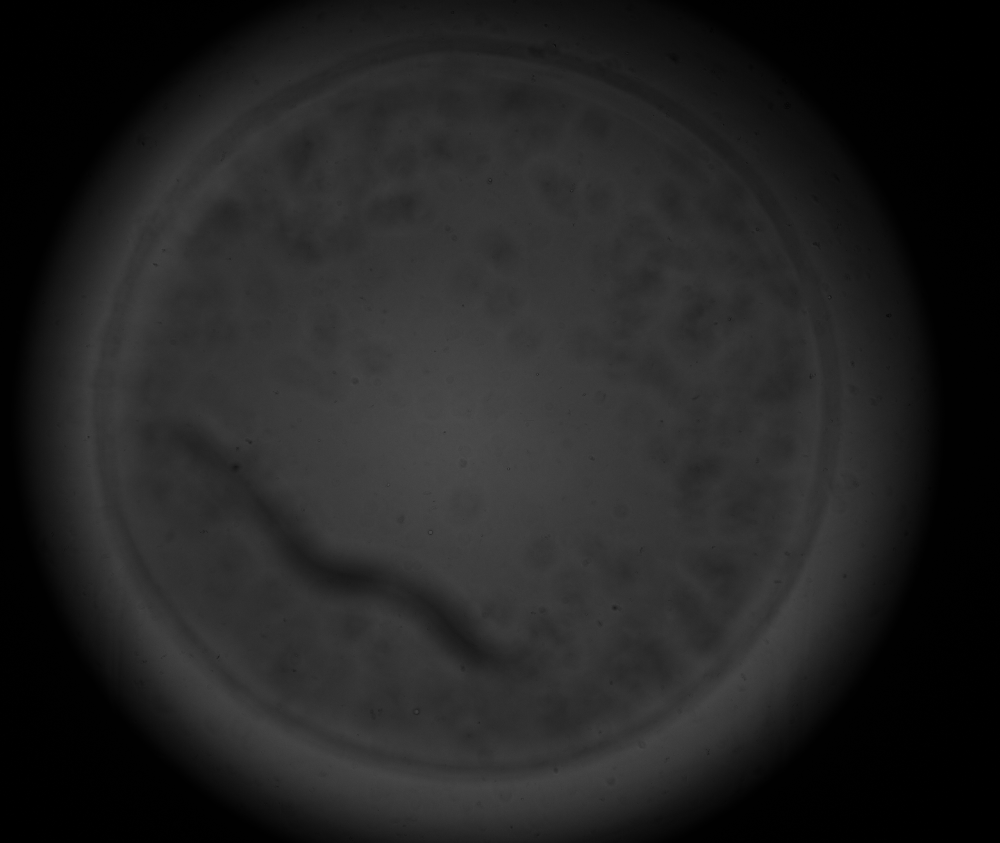

In [3]:
from IPython.display import Image
Image("/Users/zplab/Desktop/VeraPythonScripts/vera_autofocus/microscope_images/train/very_out_neg/00_2.png")

slightly_out_pos

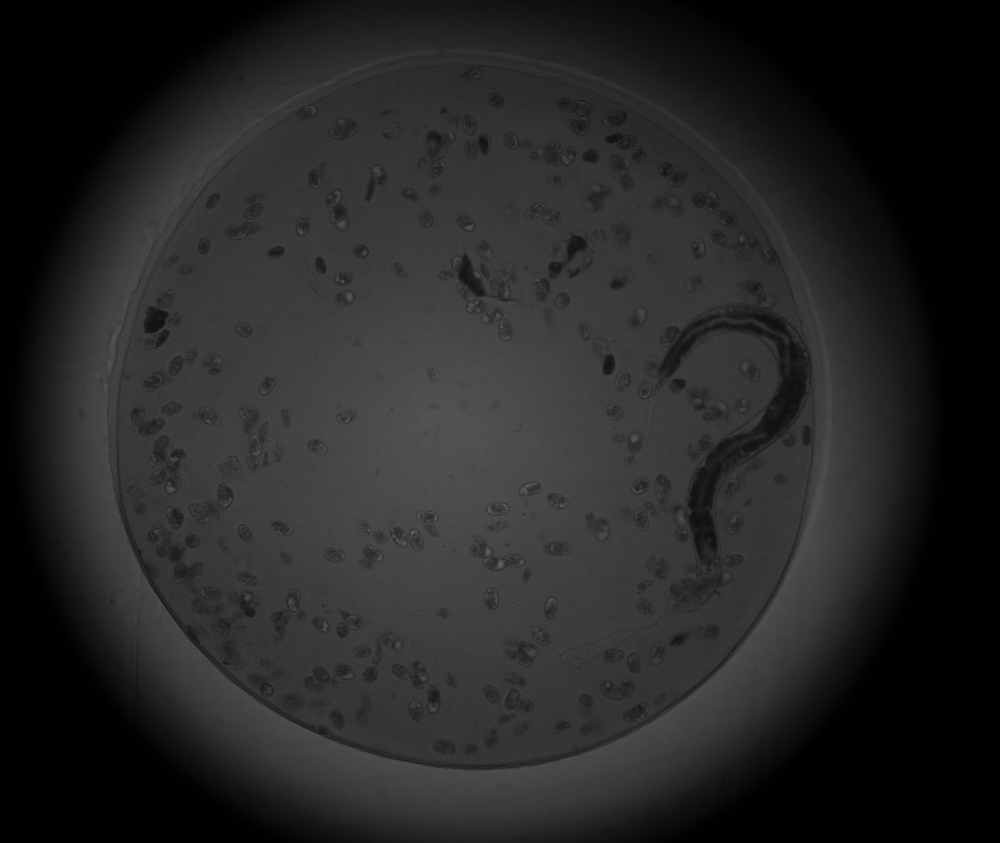

In [4]:
from IPython.display import Image
Image("/Users/zplab/Desktop/VeraPythonScripts/vera_autofocus/microscope_images/train/slightly_out_pos/22_2.png")

Acceptable

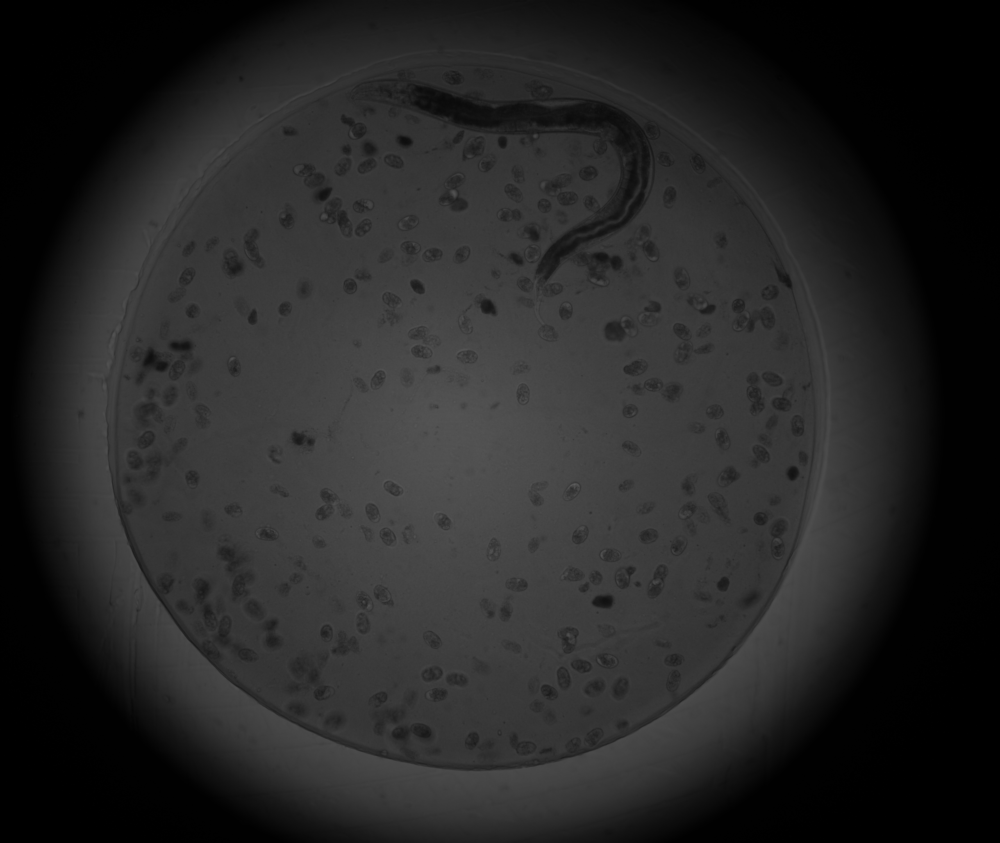

In [5]:
from IPython.display import Image
Image("/Users/zplab/Desktop/VeraPythonScripts/vera_autofocus/microscope_images/train/acceptable/19_3.png")

Next the images are loaded for training using pytorch

In [1]:
# Import all needed libraries
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms, models

data_dir = 'microscope_images'
# Make sure you are running the code from the folder that contains data_dir, or it won't work
num_train = 10
num_test = 10

# Define transforms for the training data and testing data
resnet_transforms = transforms.Compose([transforms.RandomRotation(30),
                                       transforms.RandomResizedCrop(224),
                                       transforms.RandomHorizontalFlip(),
                                       transforms.ToTensor(),
                                       transforms.Normalize([0.485, 0.456, 0.406],
                                                            [0.229, 0.224, 0.225])])


# Load the images from the image folder
traindata = datasets.ImageFolder(data_dir + '/train', transform=resnet_transforms)
testdata = datasets.ImageFolder(data_dir + '/test', transform=resnet_transforms)
# Got a lot of errors with this initially, the issue is that the images need to be in subfolders based on their
# label. This is how pytorch detects and assigns the correct labels. Originally I had all the images 
# stored in one folder and the only indicator was the file name.
# Issue and error described here https://github.com/pytorch/examples/issues/236

# Split the data into non-overlapping sets
# This line causes problems when it is run. It isn't needed for the MNIST data set since that is
# already split into training and test labelled data. Splitting the training and test data
# into folders, rather than trying to split while the program is running, seems to be the
# easier solution.
#train_data, test_data = torch.utils.data.random_split(dogs_cats_data, [num_train, (len(dogs_cats_data) - num_train)]) 

# Load from the training and test sets
trainloader = torch.utils.data.DataLoader(traindata, batch_size=num_train, shuffle=True)
testloader = torch.utils.data.DataLoader(testdata, batch_size=num_test, shuffle=True)

# Print out how many images are in the trainloader and testloader
print("Train batch size = " + str(num_train) + ', test batch size = ' + str(num_test))
print('Trainloder length = ' + str(len(trainloader)) + ', testloader length = ' + str(len(testloader)))

# Get the pre-trained model, here it is resnet50
device = torch.device("cuda" if torch.cuda.is_available() 
                                  else "cpu")
model = models.resnet50(pretrained=True)
#print(model) 
# Printing the model shows some of the internal layers, not expected to
# understand these but neat to see

# Freeze the pre-trained layers
# Re-define the final fully connected layer
# Create criterion (loss function) and set learning rate
for param in model.parameters():
    param.requires_grad = False
    
model.fc = nn.Sequential(nn.Linear(2048, 512),
                                 nn.ReLU(),
                                 nn.Dropout(0.2),
                                 nn.Linear(512, 10), # Change this to 5 for 5 class
                                 nn.LogSoftmax(dim=1))
criterion = nn.NLLLoss()
optimizer = optim.Adam(model.fc.parameters(), lr=0.003)
model.to(device)


Train batch size = 10, test batch size = 10
Trainloder length = 86, testloader length = 90


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [2]:
# Train the network
epochs = 1
steps = 0
running_loss = 0
print_every = 10
train_losses, test_losses = [], []
for epoch in range(epochs):
    for inputs, labels in trainloader:
        steps += 1
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        logps = model.forward(inputs)
        loss = criterion(logps, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        
        if steps % print_every == 0:
            test_loss = 0
            accuracy = 0
            model.eval()
            with torch.no_grad():
                for inputs, labels in testloader:
                    inputs = inputs.to(device)
                    labels = labels.to(device)
                    logps = model.forward(inputs)
                    batch_loss = criterion(logps, labels)
                    test_loss += batch_loss.item()
                    
                    ps = torch.exp(logps)
                    top_p, top_class = ps.topk(1, dim=1)
                    equals = top_class == labels.view(*top_class.shape)
                    accuracy += torch.mean(equals.type(torch.FloatTensor)).item()
            train_losses.append(running_loss/len(trainloader))
            test_losses.append(test_loss/len(testloader))                    
            print(f"Epoch {epoch+1}/{epochs}.. "
                  f"Train loss: {running_loss/print_every:.3f}.. "
                  f"Test loss: {test_loss/len(testloader):.3f}.. "
                  f"Test accuracy: {accuracy/len(testloader):.3f}")
            running_loss = 0
            model.train()
torch.save(model, 'autofocus_resnet.pth')

Epoch 1/1.. Train loss: 2.767.. Test loss: 2.214.. Test accuracy: 0.203
Epoch 1/1.. Train loss: 3.265.. Test loss: 2.191.. Test accuracy: 0.387
Epoch 1/1.. Train loss: 2.060.. Test loss: 1.529.. Test accuracy: 0.352
Epoch 1/1.. Train loss: 1.729.. Test loss: 1.606.. Test accuracy: 0.159
Epoch 1/1.. Train loss: 1.436.. Test loss: 1.562.. Test accuracy: 0.407
Epoch 1/1.. Train loss: 1.696.. Test loss: 1.498.. Test accuracy: 0.389
Epoch 1/1.. Train loss: 1.446.. Test loss: 1.435.. Test accuracy: 0.340
Epoch 1/1.. Train loss: 1.466.. Test loss: 1.426.. Test accuracy: 0.402


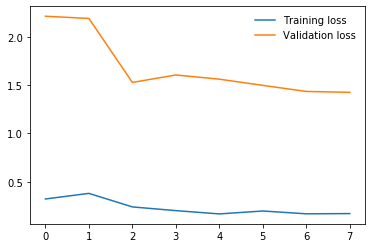

In [4]:
%matplotlib inline
plt.plot(train_losses, label='Training loss')
plt.plot(test_losses, label='Validation loss')
plt.legend(frameon=False)
plt.show()

There does seem to be some improvement in performance over rounds, this suggests the model is getting some type of training off the images. Nest steps are to improve this so the training doesn't level off at 40% accuracy, which is not useful for our purposes.